In [1]:
import selenium
import os

In [2]:
!ls ../../../../../../prog_toolbox/

chromedriver           chromedriver_mac64.zip


In [9]:
from selenium import webdriver

driver = webdriver.Chrome(executable_path='../../../../../../prog_toolbox/chromedriver')
driver.implicitly_wait(5)
driver.maximize_window()
driver.get("http://www.google.com")


In [11]:
driver.get("http://www.google.com")
driver.implicitly_wait(5)
driver.get("http://www.yahoo.com")

WebDriverException: Message: unknown error: cannot determine loading status
from disconnected: not connected to DevTools
  (Session info: chrome=89.0.4389.114)


In [32]:
import pandas as pd 
import re
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
# Import dataset
df = pd.read_csv('hk_property.csv')

# Remove unnecessary columns
df.drop(['Unnamed: 0','8'], axis = 1, inplace = True)

# df.isnull().sum() # Check for nan vaues
df.dropna(inplace = True)  # Remove first row of nan values

# #Rename columns
colnames = ['Location', 'Court/Estate Name', 'Transaction Price (HK$)', 'Saleable Floor Area (sq ft/sq m)', 'Floor', 'Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)', 'Discount Rate (%)', 'Agency (A)/Self-negotiation (S)', 'Date']  
df.columns = colnames

# Convert datetime:
df.Date = pd.to_datetime(df.Date)

# Set location as index
df = df.set_index('Date')

# Convert "string-numbers" into "integers".
df['Discount Rate (%)'] = df['Discount Rate (%)'].astype(int)
df['Transaction Price (HK$)'] = df['Transaction Price (HK$)'].apply(lambda x: x.replace(",", ""))
df['Transaction Price (HK$)'] = df['Transaction Price (HK$)'].astype(int)
df['Saleable Floor Area (sq ft/sq m)'] = df['Saleable Floor Area (sq ft/sq m)'].apply(lambda x: int(re.search('\w+', x).group()))
df['Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)'] = df['Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)'].apply(lambda x: int(x[:x.index("/")-1].replace(",", "")))

# Complete dataset
print(df)

                Location  Court/Estate Name  Transaction Price (HK$)  \
Date                                                                   
2002-01-01      Chai Wan    Cheerful Garden                  1330000   
2002-01-01      Chai Wan    Fullview Garden                   780000   
2002-01-01      Chai Wan    Fullview Garden                  1080000   
2002-01-01      Chai Wan  Greenwood Terrace                  1380000   
2002-01-01      Chai Wan    Hang Tsui Court                  1118000   
...                  ...                ...                      ...   
2021-03-01  Tin Shui Wai       Tin Fu Court                  4720000   
2021-03-01  Tin Shui Wai       Tin Fu Court                  5000000   
2021-03-01  Tin Shui Wai    Tin Shing Court                  4150000   
2021-03-01  Tin Shui Wai    Tin Shing Court                  5150000   
2021-03-01     Yuen Long     Ping Yan Court                  2980000   

            Saleable Floor Area (sq ft/sq m) Floor  \
Date     

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 41042 entries, 2002-01-01 to 2021-03-01
Data columns (total 8 columns):
 #   Column                                                        Non-Null Count  Dtype 
---  ------                                                        --------------  ----- 
 0   Location                                                      41042 non-null  object
 1   Court/Estate Name                                             41042 non-null  object
 2   Transaction Price (HK$)                                       41042 non-null  int64 
 3   Saleable Floor Area (sq ft/sq m)                              41042 non-null  int64 
 4   Floor                                                         41042 non-null  object
 5   Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)  41042 non-null  int64 
 6   Discount Rate (%)                                             41042 non-null  int64 
 7   Agency (A)/Self-negotiation (S)                             

In [6]:
print(df.index.unique(), df.Location.unique())

DatetimeIndex(['2002-01-01', '2002-02-01', '2002-03-01', '2002-04-01',
               '2002-05-01', '2002-06-01', '2002-07-01', '2002-08-01',
               '2002-09-01', '2002-10-01',
               ...
               '2020-06-01', '2020-07-01', '2020-08-01', '2020-09-01',
               '2020-10-01', '2020-11-01', '2020-12-01', '2021-01-01',
               '2021-02-01', '2021-03-01'],
              dtype='datetime64[ns]', name='Date', length=231, freq=None) ['Chai Wan' 'Quarry Bay' 'Shau Kei Wan' 'Aberdeen' 'Ap Lei Chau'
 'Kellett Bay' 'Tin Wan' 'Lam Tin' 'Ngau Tau Kok' 'Sau Mau Ping'
 'Yau Tong' 'Sham Shui Po' 'Chuk Yuen' 'Diamond Hill' 'Hammer Hill'
 'Ngau Chi Wan' 'Tsz Wan Shan' 'Wang Tau Hom' 'Wong Tai Sin' 'Mongkok'
 'Tung Chung' 'Kwai Chung' 'Tai Wo Hau' 'Tsing Yi' 'Fanling' 'Shek Wu Hui'
 'Sheung Shui' 'Tseung Kwan O' 'Ma On Shan' 'Sha Tin' 'Tai Po' 'Tuen Mun'
 'Tin Shui Wai' 'Stanley' 'Central Kowloon' 'Kwun Tong' 'Lok Fu'
 'Lai King' 'East Kowloon' 'Kowloon Bay' 'Choi Hung' 

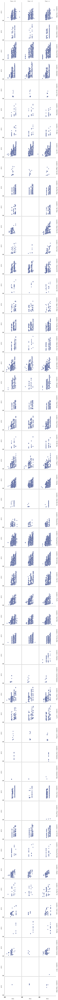

In [61]:
with sns.axes_style("white"):
    g = sns.FacetGrid(df, row="Location", col="Floor", margin_titles=True, height=2.5)
g.map(sns.scatterplot,"Saleable Floor Area (sq ft/sq m)", "Transaction Price (HK$)", color="#334488")
g.set_axis_labels("Area", "price")
g.set(xticks=[10, 30, 50], yticks=[2, 6, 10])
g.fig.subplots_adjust(wspace=.02, hspace=.02)

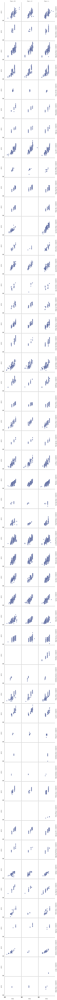

In [23]:
with sns.axes_style("white"):
    g = sns.FacetGrid(df, row="Location", col="Floor", margin_titles=True, height=2.5)
g.map(sns.scatterplot,"Saleable Floor Area (sq ft/sq m)", "normalized_price", color="#334488")
g.set_axis_labels("Area", "price")
g.set(xticks=[10, 30, 50], yticks=[2, 6, 10])
g.fig.subplots_adjust(wspace=.02, hspace=.02)

In [9]:
df.reset_index(inplace=True)
df

,Date,Location,Court/Estate Name,Transaction Price (HK$),Saleable Floor Area (sq ft/sq m),Floor,Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$),Discount Rate (%),Agency (A)/Self-negotiation (S)
0,2002-01-01,Chai Wan,Cheerful Garden,1330000,592,M,2247,51,A
1,2002-01-01,Chai Wan,Fullview Garden,780000,431,H,1812,51,A
2,2002-01-01,Chai Wan,Fullview Garden,1080000,584,M,1848,47,A
3,2002-01-01,Chai Wan,Greenwood Terrace,1380000,757,L,1824,17,A
4,2002-01-01,Chai Wan,Hang Tsui Court,1118000,559,L,2001,46,S
...,...,...,...,...,...,...,...,...,...
41037,2021-03-01,Tin Shui Wai,Tin Fu Court,4720000,650,H,7260,42,A
41038,2021-03-01,Tin Shui Wai,Tin Fu Court,5000000,650,M,7691,44,A
41039,2021-03-01,Tin Shui Wai,Tin Shing Court,4150000,535,M,7757,48,A
41040,2021-03-01,Tin Shui Wai,Tin Shing Court,5150000,650,M,7921,52,A


In [10]:
a = df[(df['Floor'] == 'M') & (df['Location'] == 'Tsuen Wan')]
a

,Date,Location,Court/Estate Name,Transaction Price (HK$),Saleable Floor Area (sq ft/sq m),Floor,Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$),Discount Rate (%),Agency (A)/Self-negotiation (S)
39205,2020-05-01,Tsuen Wan,Sheung Chui Court,5300000,438,M,12098,36,A
39635,2020-07-01,Tsuen Wan,Sheung Chui Court,5350000,438,M,12212,37,S
40199,2020-10-01,Tsuen Wan,Sheung Chui Court,5300000,438,M,12098,36,A
40203,2020-10-01,Tsuen Wan,Sheung Chui Court,5290000,439,M,12045,36,A
40622,2021-01-01,Tsuen Wan,Sheung Chui Court,5300000,438,M,12098,36,A
41014,2021-03-01,Tsuen Wan,Sheung Chui Court,5420000,439,M,12341,36,A


In [ ]:
#note: 
# 1. some data maybe too sparse or even absent
# 2. 

In [11]:
import seaborn as sns

<AxesSubplot:xlabel='Transaction Price (HK$)', ylabel='Saleable Floor Area (sq ft/sq m)'>

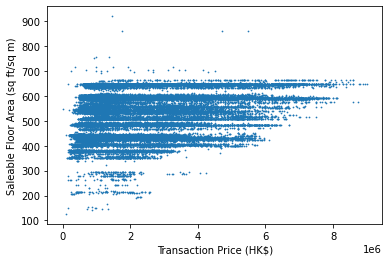

In [29]:
df.plot.scatter(x='Transaction Price (HK$)',y = 'Saleable Floor Area (sq ft/sq m)',s=0.5)

In [ ]:
df

<AxesSubplot:xlabel='Date', ylabel='Transaction Price (HK$)'>

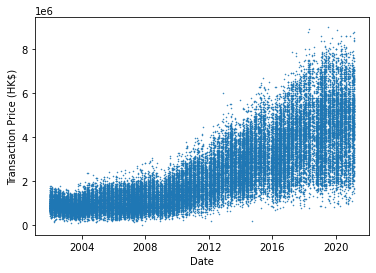

In [33]:
df.plot.scatter(x='Date',y = 'Transaction Price (HK$)',s=0.25)

In [ ]:
#prototype of house price estimator
#input: 1. Location (or court/estate)
#       2. Saleable Floor Area
#       3. Floor
#output: 1. estimated price
#        2. closest case

#for each location and each floor

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41042 entries, 0 to 41041
Data columns (total 9 columns):
 #   Column                                                        Non-Null Count  Dtype         
---  ------                                                        --------------  -----         
 0   Date                                                          41042 non-null  datetime64[ns]
 1   Location                                                      41042 non-null  object        
 2   Court/Estate Name                                             41042 non-null  object        
 3   Transaction Price (HK$)                                       41042 non-null  int64         
 4   Saleable Floor Area (sq ft/sq m)                              41042 non-null  int64         
 5   Floor                                                         41042 non-null  object        
 6   Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)  41042 non-null  int64         
 7   Disco

**build a prototype**

Input: Location, Floor and saleable floor area    Output: related cases and estimated price

1. Enlarge the valid data (due to low liquidity of real estate market, low frequency of transaction)

    **Modeling**

    1. Estimating the present value of each house. Modeling
        1. erase the effect of time to the price
            1. Simple:
            2. By assuming the distribution of price over time is the same but in different scale
                1. i.e. assume a constant time value discount rate with respect to time change
                2. constant with respect to other variables 
            3. estimate time value discount rate by mean of price at present over mean of price at time t
            4. estimate the present value of house by price times the time value discount rate
            5. Problem: unrealistic assumption
                1. time value discount rate is unlikely constant to other variables
                2. i.e. different locations have different change in price over time

                    effect of time on other variable should be erased as well (but I donot)

            very rough, not robust, 

            1. assumption should determined though correlation plot
            2. missing validation and testing step to ensure the efficiency of algorithm
            3. Advanced: fitting the time series to ARIMA, add testing&validation stuff

2. Estimating the present value of house with given condition (the input)

    **Estimating**

    1. find the related cases, like the cases with the same location, floor and similar floor area
        1. If no related cases(due to sparse data), the definition of related cases is relaxed, i.e. only with the same location and floor.
    2. estimate price by the average of present value per Floor Area among the related cases times the desired floor area. (assume linear)
    3. return the price and the related cases

sum up: This gives us a framework to estimate the house price. First we need to model the HOS secondary market, which gives us insights on the relationships of price against other variables. We will make bold but realistic assumptions on the data then try out if the model fits the data. Then we estimate the price based on the insights found though the modelling. That part is heavy load of coding work as you need to consider many cases of data and code it one by one.

<AxesSubplot:xlabel='Date', ylabel='Transaction Price (HK$)'>

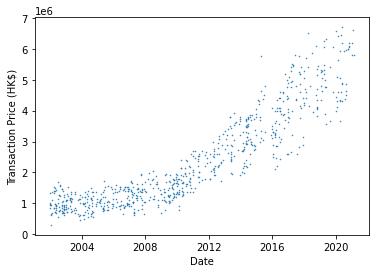

In [34]:
df[df['Location']=='Diamond Hill'].plot.scatter(x='Date',y = 'Transaction Price (HK$)',s=0.25)

In [12]:
# estimate the inflation rate by month #Assume inflation rate is unrelated to quality of house and only related to the time
# Assume distribution of house price is similar (or in the same family) with respect to time.
df[(df['Date'] == '2002-01-01') & (df.Location == 'Diamond Hill')]['Transaction Price (HK$)']

41    1000000
42     970000
43    1320000
44     850000
45     938000
Name: Transaction Price (HK$), dtype: int64

In [13]:
inflation_series = df.groupby('Date')['Transaction Price (HK$)'].mean()
now_rate = inflation_series[-1]


In [14]:
inflation_series = inflation_series.apply(lambda x: now_rate/x)
inflation_series

Date
2002-01-01    4.991971
2002-02-01    5.439512
2002-03-01    4.932618
2002-04-01    5.161678
2002-05-01    5.217887
                ...   
2020-11-01    1.087823
2020-12-01    1.100933
2021-01-01    1.061125
2021-02-01    1.027995
2021-03-01    1.000000
Name: Transaction Price (HK$), Length: 231, dtype: float64

In [15]:
inflation_series['2021-03-01']

1.0

In [16]:
df_dateindex = df.set_index('Date')
df_dateindex

,Location,Court/Estate Name,Transaction Price (HK$),Saleable Floor Area (sq ft/sq m),Floor,Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$),Discount Rate (%),Agency (A)/Self-negotiation (S)
Date,,,,,,,,
2002-01-01,Chai Wan,Cheerful Garden,1330000,592,M,2247,51,A
2002-01-01,Chai Wan,Fullview Garden,780000,431,H,1812,51,A
2002-01-01,Chai Wan,Fullview Garden,1080000,584,M,1848,47,A
2002-01-01,Chai Wan,Greenwood Terrace,1380000,757,L,1824,17,A
2002-01-01,Chai Wan,Hang Tsui Court,1118000,559,L,2001,46,S
...,...,...,...,...,...,...,...,...
2021-03-01,Tin Shui Wai,Tin Fu Court,4720000,650,H,7260,42,A
2021-03-01,Tin Shui Wai,Tin Fu Court,5000000,650,M,7691,44,A
2021-03-01,Tin Shui Wai,Tin Shing Court,4150000,535,M,7757,48,A


In [17]:
df['inflation'] = df['Date'].apply(lambda x: inflation_series[x])
df

,Date,Location,Court/Estate Name,Transaction Price (HK$),Saleable Floor Area (sq ft/sq m),Floor,Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$),Discount Rate (%),Agency (A)/Self-negotiation (S),inflation
0,2002-01-01,Chai Wan,Cheerful Garden,1330000,592,M,2247,51,A,4.991971
1,2002-01-01,Chai Wan,Fullview Garden,780000,431,H,1812,51,A,4.991971
2,2002-01-01,Chai Wan,Fullview Garden,1080000,584,M,1848,47,A,4.991971
3,2002-01-01,Chai Wan,Greenwood Terrace,1380000,757,L,1824,17,A,4.991971
4,2002-01-01,Chai Wan,Hang Tsui Court,1118000,559,L,2001,46,S,4.991971
...,...,...,...,...,...,...,...,...,...,...
41037,2021-03-01,Tin Shui Wai,Tin Fu Court,4720000,650,H,7260,42,A,1.000000
41038,2021-03-01,Tin Shui Wai,Tin Fu Court,5000000,650,M,7691,44,A,1.000000
41039,2021-03-01,Tin Shui Wai,Tin Shing Court,4150000,535,M,7757,48,A,1.000000
41040,2021-03-01,Tin Shui Wai,Tin Shing Court,5150000,650,M,7921,52,A,1.000000


In [18]:
#normalized to last month price, assume no inflation rate between last and this month: current price!
df['normalized_price'] = df['Transaction Price (HK$)']*df['inflation']

<AxesSubplot:xlabel='Date', ylabel='normalized_price'>

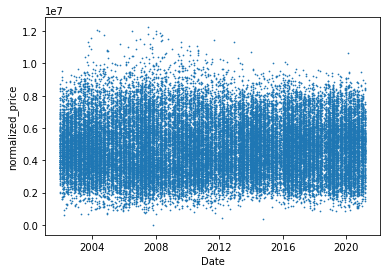

In [19]:
df.plot.scatter(x='Date',y='normalized_price',s=0.5)

In [ ]:
#plot data price against area

<AxesSubplot:xlabel='Date', ylabel='Transaction Price (HK$)'>

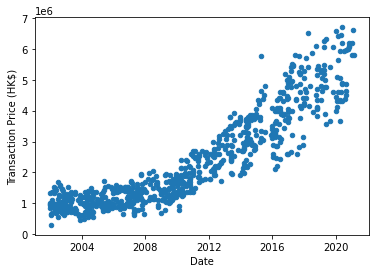

In [58]:
df[df['Location']=='Diamond Hill'].plot.scatter(x='Date',y='Transaction Price (HK$)')

<AxesSubplot:xlabel='Date', ylabel='normalized_price'>

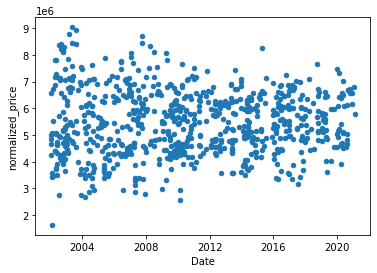

In [56]:
df[df['Location']=='Diamond Hill'].plot.scatter(x='Date',y='normalized_price')

<AxesSubplot:xlabel='Saleable Floor Area (sq ft/sq m)', ylabel='normalized_price'>

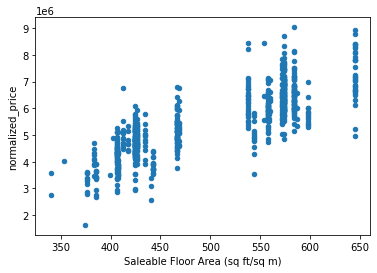

In [57]:
df[df['Location']=='Diamond Hill'].plot.scatter(x='Saleable Floor Area (sq ft/sq m)',y='normalized_price')

In [20]:
def find_nearest_point(Location, Floor, area, df):
    if (Location not in df['Location'].unique()) or (Floor not in df['Floor'].unique()):
        print('Wrong location or floor input.')
        return None

    sub_df = df[(df["Location"] == Location) & (df['Floor'] == Floor)]
    if sub_df.shape[0]:
        cases = sub_df[(sub_df['Saleable Floor Area (sq ft/sq m)']<area+15) & (sub_df['Saleable Floor Area (sq ft/sq m)']>area-15)]
        if not cases.shape[0]:
            cases = sub_df
    else:
        cases = df[df["Location"] == Location]
    price = cases['normalized_price'].sum()/cases['Saleable Floor Area (sq ft/sq m)'].sum() * area
    return price,cases


In [21]:
testing_df = df[df['Date']< '2021-03-01']

In [22]:
validation_df = df[df['Date'] == '2021-03-01']

In [23]:
validation_df['Date'].shape

(174,)

In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41042 entries, 0 to 41041
Data columns (total 11 columns):
 #   Column                                                        Non-Null Count  Dtype         
---  ------                                                        --------------  -----         
 0   Date                                                          41042 non-null  datetime64[ns]
 1   Location                                                      41042 non-null  object        
 2   Court/Estate Name                                             41042 non-null  object        
 3   Transaction Price (HK$)                                       41042 non-null  int64         
 4   Saleable Floor Area (sq ft/sq m)                              41042 non-null  int64         
 5   Floor                                                         41042 non-null  object        
 6   Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)  41042 non-null  int64         
 7   Disc

In [25]:
prediction_list = [find_nearest_point(location, floor, area, testing_df)[0] for location, floor, area in zip(validation_df['Location'], validation_df['Floor'], validation_df['Saleable Floor Area (sq ft/sq m)'])]

In [26]:
#percentage AE
AE_pct = [ abs(predict-true)/true for predict, true in zip(prediction_list, validation_df['Transaction Price (HK$)'].to_list())]

Text(0.5, 0, 'error percentage')

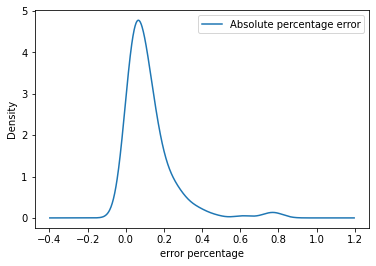

In [33]:
#print
df_error = pd.DataFrame({'Absolute percentage error':AE_pct})
df_error.plot(kind = 'kde', xlabel = 'error percentage')
plt.xlabel('error percentage')

In [83]:
#MAE
df_error.sum()/df_error.shape[0]
#error=    0.1211

error    0.1211
dtype: float64

In [86]:
174-99

75

In [85]:
#test if it tends to overshoot or undershoot
E_pct = [ (predict-true)/true for predict, true in zip(prediction_list, validation_df['Transaction Price (HK$)'].to_list())]
pn = [1 if i >0 else -1 for i in E_pct]
sum(pn)

24

In [56]:
find_nearest_point('Tsuen Wan', 'M', 430, df)

(5626671.303783861,
             Date   Location  Court/Estate Name  Transaction Price (HK$)  \
 39205 2020-05-01  Tsuen Wan  Sheung Chui Court                  5300000   
 39635 2020-07-01  Tsuen Wan  Sheung Chui Court                  5350000   
 40199 2020-10-01  Tsuen Wan  Sheung Chui Court                  5300000   
 40203 2020-10-01  Tsuen Wan  Sheung Chui Court                  5290000   
 40622 2021-01-01  Tsuen Wan  Sheung Chui Court                  5300000   
 41014 2021-03-01  Tsuen Wan  Sheung Chui Court                  5420000   
 
        Saleable Floor Area (sq ft/sq m) Floor  \
 39205                               438     M   
 39635                               438     M   
 40199                               438     M   
 40203                               439     M   
 40622                               438     M   
 41014                               439     M   
 
        Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)  \
 39205                

In [ ]:
##the inflation should be done location wise!!!!!!!!!!!!!!!!!!!!!!! But there is too few data point!! should have capture the offering price
##FLAGFLAG

In [57]:
sub_df = df[(df['Floor'] == 'M') & (df['Location'] == 'Tsuen Wan')]
sub_df['Transaction Price (HK$)'].sum()/sub_df['Saleable Floor Area (sq ft/sq m)'].sum()*438

5322615.969581749

In [42]:
sub_df

,Date,Location,Court/Estate Name,Transaction Price (HK$),Saleable Floor Area (sq ft/sq m),Floor,Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$),Discount Rate (%),Agency (A)/Self-negotiation (S),inflation,normalized_price
39205,2020-05-01,Tsuen Wan,Sheung Chui Court,5300000,438,M,12098,36,A,1.019480,5.403242e+06
39635,2020-07-01,Tsuen Wan,Sheung Chui Court,5350000,438,M,12212,37,S,1.029678,5.508779e+06
40199,2020-10-01,Tsuen Wan,Sheung Chui Court,5300000,438,M,12098,36,A,1.117067,5.920453e+06
40203,2020-10-01,Tsuen Wan,Sheung Chui Court,5290000,439,M,12045,36,A,1.117067,5.909283e+06
40622,2021-01-01,Tsuen Wan,Sheung Chui Court,5300000,438,M,12098,36,A,1.061125,5.623963e+06
41014,2021-03-01,Tsuen Wan,Sheung Chui Court,5420000,439,M,12341,36,A,1.000000,5.420000e+06


In [44]:
#boardcast the date
df_dateindex

,Location,Court/Estate Name,Transaction Price (HK$),Saleable Floor Area (sq ft/sq m),Floor,Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$),Discount Rate (%),Agency (A)/Self-negotiation (S)
Date,,,,,,,,
2002-01-01,Chai Wan,Cheerful Garden,1330000,592,M,2247,51,A
2002-01-01,Chai Wan,Fullview Garden,780000,431,H,1812,51,A
2002-01-01,Chai Wan,Fullview Garden,1080000,584,M,1848,47,A
2002-01-01,Chai Wan,Greenwood Terrace,1380000,757,L,1824,17,A
2002-01-01,Chai Wan,Hang Tsui Court,1118000,559,L,2001,46,S
...,...,...,...,...,...,...,...,...
2021-03-01,Tin Shui Wai,Tin Fu Court,4720000,650,H,7260,42,A
2021-03-01,Tin Shui Wai,Tin Fu Court,5000000,650,M,7691,44,A
2021-03-01,Tin Shui Wai,Tin Shing Court,4150000,535,M,7757,48,A


SyntaxError: invalid syntax (<ipython-input-1-f425a9762724>, line 2)

In [34]:
df.columns

Index(['Date', 'Location', 'Court/Estate Name', 'Transaction Price (HK$)',
       'Saleable Floor Area (sq ft/sq m)', 'Floor',
       'Transaction Price per sq ft/sq m (Saleable Floor Area) (HK$)',
       'Discount Rate (%)', 'Agency (A)/Self-negotiation (S)', 'inflation',
       'normalized_price'],
      dtype='object')